### Week 3: CNN Cancer Detection Kaggle Mini-Project

### For this week's mini-project, you will participate in this Kaggle competition: 

#### Histopathologic Cancer Detection

This Kaggle competition is a binary image classification problem where you will identify metastatic cancer in small image patches taken from larger digital pathology scans.

The project has 125 total points. The instructions summarize the criteria you will use to guide your submission and review others' submissions. Note: to receive total points for this section, the learner doesn't need to have a top-performing score on the challenge. As a mini-project to complete as a weekly assignment, we don't expect you to iterate over your project until you have a model capable of winning the challenge. The iterative process takes time, so please start early to get better-quality results and reports. The learner needs to show a score that reasonably reflects that they completed the rubric parts of this project. The grades are more based on the quality and depth of the analysis, not just on a better Kaggle score.

##### Deliverable 1 — 
A Jupyter notebook with a description of the problem/data, exploratory data analysis (EDA) procedure, analysis (model building and training), result, and discussion/conclusion. 

Suppose your work becomes so large that it doesn’t fit into one notebook (or you think it will be less readable by having one large notebook). In that case, you can make several notebooks or scripts in a GitHub repository (as deliverable 3) and submit a report-style notebook or pdf instead. 

If your project doesn’t fit into Jupyter notebook format (E.g., you built an app that uses ML), write your approach as a report and submit it in a pdf form. 

##### Deliverable 2 — 
A public project GitHub repository with your work (please also include the GitHub repo URL in your notebook/report).

##### Deliverable 3 — 
A screenshot of your position on the Kaggle competition leaderboard for your top-performing model.



### import libraries

In [42]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
from IPython.display import display
from PIL import Image
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import f1_score, roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.regularizers import l2
from kerastuner.tuners import BayesianOptimization
from pandarallel import pandarallel

from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.regularizers import l2


In [2]:
pandarallel.initialize()

INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use standard multiprocessing data transfer (pipe) to transfer data between the main process and workers.


### path definitions

In [4]:
def initialize_paths():
    
    """
    this function gets all paths to use in this study.
    """

    base_path = r"/Users/flaviab/Downloads/histopathologic-cancer-detection/train"
    csv_path = r"/Users/flaviab/Downloads/histopathologic-cancer-detection/train_labels.csv"
    base_path_test = r"/Users/flaviab/Downloads/histopathologic-cancer-detection/test"
    path = r"/Users/flaviab/Downloads/histopathologic-cancer-detection/train/0a0ce1220f56a48bf14615f80bc4c684244c909d.tif"
    output_directory = r"/Users/flaviab/Downloads/histopathologic-cancer-detection/outputs"
    
    return base_path, csv_path, base_path_test, path, output_directory


base_path, csv_path, base_path_test, path, output_directory = initialize_paths()


### get data

In [6]:
class DataPreparation:
    
    def __init__(self, train_base_path: str, csv_path: str, test_base_path: str):
        self.train_base_path = train_base_path
        self.csv_path = csv_path
        self.test_base_path = test_base_path
        
    def _make_path(self, id_str: str, base_path: str) -> str:
        
        """
        generate the full file path based on the given id.
        """
        return os.path.join(base_path, f"{id_str}.tif")
    
    def prepare_train_labels(self) -> pd.DataFrame:
        
        """
        prepare train labels dataframe with proper filename paths and labels.
        """
        df = pd.read_csv(self.csv_path)
        df["filename"] = df["id"].apply(lambda x: self._make_path(x, self.train_base_path))
        df["label"] = df["label"].astype(str)
        return df
    
    def prepare_test_data(self) -> pd.DataFrame:
        
        """
        prepare test data dataframe with proper filename paths.
        """
        df = pd.DataFrame()
        df['filename'] = [os.path.join(self.test_base_path, filename) for filename in os.listdir(self.test_base_path)]
        df["id"] = [filename[:-4] for filename in os.listdir(self.test_base_path)]
        return df


data_preparer = DataPreparation(base_path, csv_path, base_path_test)
train_data = data_preparer.prepare_train_labels()
test_data = data_preparer.prepare_test_data()


### Instructions: Step 1
    - Brief description of the problem and data (5 pts) 
    - Briefly describe the challenge problem and NLP. Describe the size, dimension, structure, etc., of the data. 

##### Histopathologic Cancer Detection Challenge

The problem: This challenge is about finding specific cancer cells in detailed scans of lymph nodes. These cancer cells can move from their original spot to other places in the body, often starting with the lymph nodes. Catching them early can really help a patient's chances.

Natural Language Processing (NLP):
NLP is a part of artificial intelligence that helps computers understand and respond to human language. 

The image we just printed below shows cells from a tissue, sized 96x96 pixels, and uses the RGB scale, that captures color information in images. This color data can be crucial as different classes might have distinct color patterns. 


Image Shape = (96, 96, 3)


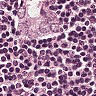

In [9]:
def load_and_display_image(path: str):
    
    """
    load an image from the provided path and display it in the Jupyter notebook.
    """

    with Image.open(path) as img:
        img_array = np.array(img)
        print(f"Image Shape = {img_array.shape}")
        display(img)

load_and_display_image(path)



### Instructions: Step 2

#### Exploratory Data Analysis (EDA) — Inspect, Visualize and Clean the Data (15 pts)

- Show a few visualizations like histograms. 
- Describe any data cleaning procedures. 
- Based on your EDA, what is your plan of analysis? 

EDA Plan:

0. Load Data
1. EDA: check values distribuition and general info 
2. EDA: check missing values
3. EDA: Check duplicated lines
4. EDA: Check unbalanced data (cancer/not cancer)
5. EDA: Plot data
6. EDA: Plot part of the images to briefly analyze them and get possible insights


##### checking missing values 

In [141]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220025 entries, 0 to 220024
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   id        220025 non-null  object
 1   label     220025 non-null  object
 2   filename  220025 non-null  object
dtypes: object(3)
memory usage: 5.0+ MB


In [142]:
train_data.dtypes

id          object
label       object
filename    object
dtype: object

In [143]:
train_data['label'] = train_data['label'].astype(str)

In [144]:
train_data.describe()

,label
count,220025.000000
mean,0.405031
std,0.490899
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


##### checking for duplicated rows

In [145]:
train_data.loc[train_data.duplicated()]

,id,label,filename


##### checking for unbalanced data

In [146]:
train_data.label.value_counts()

0    130908
1     89117
Name: label, dtype: int64

##### plot data

In [10]:
def plot_label_distribution(train_data: pd.DataFrame) -> None:
    
    """
    Plots the distribution of categories in the given training dataset.
    """
    
    plot_data = train_data.groupby('label').agg(no_samples = ('id','count')).reset_index()
    plot_data['%_labels'] = round((plot_data.no_samples/plot_data.no_samples.sum())*100,2)

    fig = px.bar(plot_data, x="label", y="%_labels", 
                 title='Distribution of categories in the training dataset', 
                 text='%_labels')

    fig.show()


plot_label_distribution(train_data)


even though the data is slightly unbalanced, there's no reason to implement big techniquies. 

##### check images

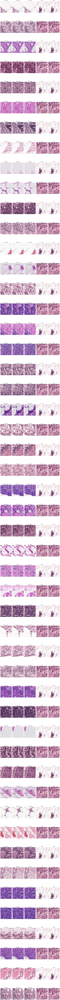

In [25]:
def load_subset_images(df, label, num_images=50):
    
    """
    get images of both labels (cancer/not cancer) and display it to human analysis.
    """
    
    filenames = df[df['label'] == label]['filename'].head(num_images).tolist()
    return [Image.open(filename) for filename in filenames]

label_0_images = load_subset_images(train_data, '0')
label_1_images = load_subset_images(train_data, '1')

def display_side_by_side(images_0, images_1, label_0="Not Cancer", label_1="Cancer"):
    
    """
    fix display to better comparison.
    """
    
    total_cols = 5 
    total_rows = max(len(images_0), len(images_1))
    
    fig, axs = plt.subplots(total_rows, total_cols, figsize=(15, 5*total_rows))
    
    for i in range(total_rows):
        for j in range(total_cols):
            axs[i, j].axis('off')
            if j < 3 and i < len(images_0):  
                axs[i, j].imshow(images_0[i])
                axs[i, j].set_title(label_0)
            elif j >= 3 and i < len(images_1): 
                axs[i, j].imshow(images_1[i % 2])
                axs[i, j].set_title(label_1)

    plt.tight_layout()
    plt.show()

display_side_by_side(label_0_images, label_1_images)

Given the results in the images shown below, the cancer and not cancer images have complex features and somehow similar that would make hard to detect each one by just the human eye. The images alone aren't enough to help me get better insight to add the model.

##### create generator to load data in batches

In [26]:
train_data['label'] = train_data['label'].astype(str)

In [29]:
def create_data_generators(dataframe, test_dataframe, target_size=(96, 96), batch_size=50, validation_split=0.25):

    """
    create train, validation, and test generators from dataframes.

    """

    datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
        brightness_range=[0.7,1.3],
        validation_split=validation_split
    )
    
    data_train = datagen.flow_from_dataframe(
        dataframe=dataframe,
        x_col="filename",
        y_col="label",
        target_size=target_size,
        color_mode="rgb",
        batch_size=batch_size,
        class_mode="binary",
        subset="training",
        validate_filenames=False
    )
    
    data_val = datagen.flow_from_dataframe(
        dataframe=dataframe,
        x_col="filename",
        y_col="label",
        target_size=target_size,
        color_mode="rgb",
        batch_size=batch_size,
        class_mode="binary",
        subset="validation",
        validate_filenames=False
    )

    data_test = ImageDataGenerator(rescale=1./255).flow_from_dataframe(
        dataframe=test_dataframe,
        x_col="filename",
        target_size=target_size,
        color_mode="rgb",
        batch_size=batch_size,
        class_mode=None, 
        shuffle=False,
        validate_filenames=False
    )
    
    return data_train, data_val, data_test


data_train, data_val, data_test = create_data_generators(train_data, test_data)

Found 165019 non-validated image filenames belonging to 2 classes.
Found 55006 non-validated image filenames belonging to 2 classes.
Found 57458 non-validated image filenames.


### Hyperparameter search - test with no training improvement strategy

### Instructions: Step 3

    - Describe the architecture of your model and why you think that particular architecture would be suitable for this problem. 
    - Compare multiple architectures and adjust hyperparameters.

##### Architecture's description:

    1. Baseline:
    - Starts with two conv2D layers having 32 filters and then 64 filters;
    - Each of these layers is followed up by a pooling step using maxpooling2D;
    - The data is then flattened and pushed through a dense layer packed with 128 neurons;
    - At the end, there's just one neuron giving the final output, and it uses a sigmoid activation;
    
    I've set up a baseline before training a more complex model to get a starting point. It was helpful to give a general idea of how much progress the solution made as it moved forward. This baseline was made to provide a simpler solution to the problem with more basic concepts of neural networls.

    2. Deep Model:
    - This one takes inspiration from the baseline but goes deeper with added conv2d and maxpooling2D layers;
    - For smoother learning, it's got batch normalization, and to keep things in check and avoid overfitting, there's a dropout layer in place;

    3. Transfer Learning Model:
    - This model it's based on the resnet50, a pretrained model, but without its usual top layer;
    - After processing through resnet50, the data is flattened and goes through a dense layer with 128 neurons;
    - Finally, a single neuron, activated by a sigmoid function, wraps things up;
    
    Resnet was picked because is a deep neural network with "shortcuts" features that help it learn better and avoid some common pitfalls, hence it's fit to help spotting the tricky patterns in cancer detection images. Since resmet is trained with data from previous big datasets, it gets a good start. Plus, its design keeps it from easy overfit, which is desirable in this case. All in all, resnet's depth and prior knowledge make it a top choice for diving deep into complex cancer images.

In [98]:
leaky_relu = LeakyReLU(alpha=0.01)


In [99]:
%%time

def build_model(hp):
    """
    This snippet defines a function to build a neural network model. 
    Depending on a choice parameter, it constructs a baseline, deep neural, or a transfer learning resnet based model.
    The code uses Adam optimizer, and returns the configured model.
    """
    
    model_choice = hp.Choice('model_type', ['baseline', 'deep', 'transfer'])

    model = Sequential() 
    
    if model_choice == 'baseline':
        model.add(Conv2D(32, (3,3), activation=leaky_relu, kernel_regularizer=l2(0.01), input_shape=(96, 96, 3)))
        model.add(MaxPooling2D(2,2))
        model.add(Conv2D(64, (3,3), activation=leaky_relu, kernel_regularizer=l2(0.01)))
        model.add(MaxPooling2D(2,2))
        model.add(Flatten())
        model.add(Dense(128, activation='relu'))
        model.add(Dense(1, activation='sigmoid'))
        
    
    elif model_choice == 'deep':
        model.add(Conv2D(32, (3,3), activation=leaky_relu, kernel_regularizer=l2(0.01), input_shape=(96, 96, 3)))
        model.add(MaxPooling2D(2,2))
        model.add(BatchNormalization())
        model.add(Conv2D(64, (3,3), activation=leaky_relu))
        model.add(MaxPooling2D(2,2))
        model.add(BatchNormalization())
        model.add(Conv2D(128, (3,3), activation=leaky_relu))
        model.add(MaxPooling2D(2,2))
        model.add(BatchNormalization())
        model.add(Conv2D(256, (3,3), activation=leaky_relu))
        model.add(MaxPooling2D(2,2))
        model.add(BatchNormalization())
        model.add(Flatten())
        model.add(Dense(128, activation='relu'))
        model.add(Dropout(0.5))
        model.add(Dense(1, activation='sigmoid'))
    
    else:  # 'transfer'
        base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(96, 96, 3))
        model.add(base_model)
        model.add(Flatten())
        model.add(Dense(128, activation='relu'))
        model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer=tf.keras.optimizers.Adam(hp.Float('learning_rate', 1e-4, 1e-2, sampling='log')),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    return model


CPU times: user 16 µs, sys: 231 µs, total: 247 µs
Wall time: 726 µs


In [39]:
def compute_class_weights(data_train):
    
    """
    Compute class weights based on the classes of the training data.
    """
    
    weights = class_weight.compute_class_weight('balanced', np.unique(data_train.classes), data_train.classes)
    class_weights = {0: weights[0], 1: weights[1]}
    
    return class_weights


In [ ]:
tuner = BayesianOptimization(
    build_model,
    objective= 'val_accuracy',
    max_trials= 5,
    num_initial_points= 2,
    directory= output_directory,
    project_name= 'histopathologic_cancer_detection_bayesian'
)

tuner.search(data_train, epochs=10, validation_data=data_val)
best_model = tuner.get_best_models(num_models=1)[0]
loss, accuracy = best_model.evaluate(data_test, test_labels)

print(f"Best model accuracy on test set: {accuracy:.4f}")


Trial 4 Complete [1d 01h 50m 54s]
val_accuracy: 0.9264989495277405

Best val_accuracy So Far: 0.9593862295150757
Total elapsed time: 2d 09h 15m 34s

Search: Running Trial #5

Value             |Best Value So Far |Hyperparameter
transfer          |transfer          |model_type
0.0001            |0.00014623        |learning_rate

Epoch 1/10
3301/3301 [==============================] - 8142s 2s/step - loss: 0.2015 - accuracy: 0.9232 - val_loss: 0.2051 - val_accuracy: 0.9310
Epoch 2/10
3301/3301 [==============================] - 8160s 2s/step - loss: 0.1174 - accuracy: 0.9578 - val_loss: 0.1350 - val_accuracy: 0.9524
Epoch 3/10
3301/3301 [==============================] - 10404s 3s/step - loss: 0.0810 - accuracy: 0.9711 - val_loss: 0.1311 - val_accuracy: 0.9543
Epoch 4/10
3301/3301 [==============================] - 9622s 3s/step - loss: 0.0603 - accuracy: 0.9784 - val_loss: 0.1847 - val_accuracy: 0.9444
Epoch 5/10
3301/3301 [==============================] - 10321s 3s/step - loss: 0.0473

### Hyperparameter search - test implementing improvement strategy

### Instructions: Step 4 - Results and analysis (35 pts)

    - Perform hyperparameter tuning, try different architectures for comparison, apply techniques to improve training or performance, and discuss what helped.

    - Includes results with tables and figures. There is a breakdown of why something worked well or not, troubleshooting, and a summary of the hyperparameter optimization procedure.

    As seen above, the code without performance implementations took days to run. This approach turned out to be inefficient and undesirable. For this reason, some changes were made to the code.
    
    The new approach sets up a few training enhancements: 

    1. Early stopping halts training if validation accuracy stalls for 3 epochs;
    2. Learning rate reduction halves the learning rate if validation loss doesn't improve for 2 epochs;
    3. Reduced number of trials and epochs;
    
    
    In both cases, the bayesian optimization technique for hyperparameter tuning was picked for its intelligent way of selecting the next set of hyperparameters to test based on prior results, reducing unnecessary trials and thus saving time and CPU/GPU memory, which was very needed.

In [45]:
%%time

early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True)
lr_reduction = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, verbose=1, min_lr=1e-6)

tuner2 = BayesianOptimization(
    build_model,
    objective= 'val_accuracy',
    max_trials= 5,
    num_initial_points= 2,
    directory= output_directory,
    project_name= 'histopathologic_cancer_detection_bayesian'
)


INFO:tensorflow:Reloading Tuner from /Users/flaviab/Downloads/histopathologic-cancer-detection/outputs/histopathologic_cancer_detection_bayesian/tuner0.json
CPU times: user 8.64 ms, sys: 6.59 ms, total: 15.2 ms
Wall time: 16.2 ms


In [46]:
%%time

tuner2.search(data_train, epochs=10, validation_data=data_val, callbacks=[early_stopping, lr_reduction])
best_model = tuner2.get_best_models(num_models=1)[0]

Trial 5 Complete [03h 31m 25s]
val_accuracy: 0.8573610186576843

Best val_accuracy So Far: 0.8935752511024475
Total elapsed time: 15h 27m 35s
INFO:tensorflow:Oracle triggered exit
CPU times: user 2d 9h 2min 9s, sys: 23h 31min 53s, total: 3d 8h 34min 3s
Wall time: 15h 27min 39s


In [47]:
%%time

predictions = best_model.predict(data_test)

1150/1150 [==============================] - 117s 101ms/step
CPU times: user 6min 42s, sys: 3min 12s, total: 9min 54s
Wall time: 1min 57s


In [48]:
predictions

array([[0.3938094 ],
       [0.02698293],
       [0.53511846],
       ...,
       [0.02612994],
       [0.03567813],
       [0.9624141 ]], dtype=float32)

### model evaluation

In [53]:
%%time

def optimize_and_evaluate_model(build_model_function, 
                                data_train, 
                                data_val, 
                                data_test,
                                output_directory,
                                max_trials=4, 
                                epochs=6,
                                num_initial_points=2, 
                                project_name='histopathologic_cancer_detection_bayesian'):
    """
    Optimize a Keras model using Bayesian optimization and evaluate its performance.
    """

    tuner2 = BayesianOptimization(
        build_model_function,
        objective='val_accuracy',
        max_trials=max_trials,
        num_initial_points=num_initial_points,
        directory=output_directory,
        project_name=project_name
    )

    tuner2.search(data_train, epochs=epochs, validation_data=data_val)
    best_model = tuner2.get_best_models(num_models=1)[0]
    
    val_loss, val_accuracy = best_model.evaluate(data_val)
    print(f"Validation Accuracy: {val_accuracy*100:.2f}%")
    print(f"Validation Loss: {val_loss:.4f}")

    return best_model, val_loss, val_accuracy, tuner2

best_model, val_loss, val_accuracy, tuner2 = optimize_and_evaluate_model(build_model, data_train, data_val, data_test, output_directory)


INFO:tensorflow:Reloading Tuner from /Users/flaviab/Downloads/histopathologic-cancer-detection/outputs/histopathologic_cancer_detection_bayesian/tuner0.json
INFO:tensorflow:Oracle triggered exit
1101/1101 [==============================] - 238s 216ms/step - loss: 0.6654 - accuracy: 0.8062
Validation Accuracy: 80.62%
Validation Loss: 0.6654
CPU times: user 8min 25s, sys: 2min 56s, total: 11min 22s
Wall time: 4min 8s


In [62]:
%%time

def evaluate_and_plot_results(model, validation_data):
    """
    Evaluate model on validation data and visualize the results.
    
    Parameters:
    - model: Keras model.
    - validation_data: Validation data generator.
    
    Returns:
    None. (Displays plots and prints results.)
    """
    
    # Predict on validation data
    val_predictions = model.predict(validation_data)
    binary_predictions = np.round(val_predictions).astype(int)
    true_labels = validation_data.labels

    # Create confusion matrix
    matrix = confusion_matrix(true_labels, binary_predictions)
    
    # Plotly heatmap for confusion matrix
    z = matrix.tolist()
    x = ['Predicted 0', 'Predicted 1']
    y = ['Actual 0', 'Actual 1']
    fig = ff.create_annotated_heatmap(z, x=x, y=y, colorscale='Blues', showscale=False)
    fig.update_layout(title='Confusion Matrix')
    
    fig.show()

    # Classification report
    report = classification_report(true_labels, binary_predictions, output_dict=True)
    print(classification_report(true_labels, binary_predictions))
    
    # Plotly bar chart for classification report
    report_data = [{'label': label, **metrics} for label, metrics in report.items() if label.isdigit()]
    df = pd.DataFrame.from_dict(report_data)
    
    fig = go.Figure()
    for metric in ['precision', 'recall', 'f1-score']:
        fig.add_trace(go.Bar(x=df['label'], y=df[metric], name=metric))
    fig.update_layout(title='Classification Report', 
                      xaxis_title='Class', 
                      yaxis_title='Score', 
                      yaxis=dict(range=[0,1]))
    fig.show()

evaluate_and_plot_results(best_model, data_val)


1101/1101 [==============================] - 251s 228ms/step


              precision    recall  f1-score   support

           0       0.60      0.51      0.55     32758
           1       0.40      0.49      0.44     22248

    accuracy                           0.50     55006
   macro avg       0.50      0.50      0.50     55006
weighted avg       0.52      0.50      0.51     55006



CPU times: user 8min 33s, sys: 3min, total: 11min 34s
Wall time: 4min 11s


In [72]:
train_labels = np.concatenate([data_train[i][1] for i in range(len(data_train))])
unique, counts = np.unique(train_labels, return_counts=True)
total_samples = len(train_labels)
n_classes = len(unique)
class_weights = {class_label: total_samples / (n_classes * count) for class_label, count in zip(unique, counts)}


In [78]:
true_labels = data_val.labels

In [79]:
%%time 

val_predictions = best_model.predict(data_val)
thresholds = np.arange(0, 1.05, 0.05)
f1_scores = [f1_score(true_labels, np.where(val_predictions > t, 1, 0)) for t in thresholds]
optimal_threshold = thresholds[np.argmax(f1_scores)]

1101/1101 [==============================] - 232s 211ms/step
CPU times: user 8min 18s, sys: 3min 3s, total: 11min 22s
Wall time: 3min 53s


### evaluate train x validation

[[0.9286627769470215], [0.5944527387619019], [0.9166581034660339], [0.8354189395904541], [0.9500481486320496]]


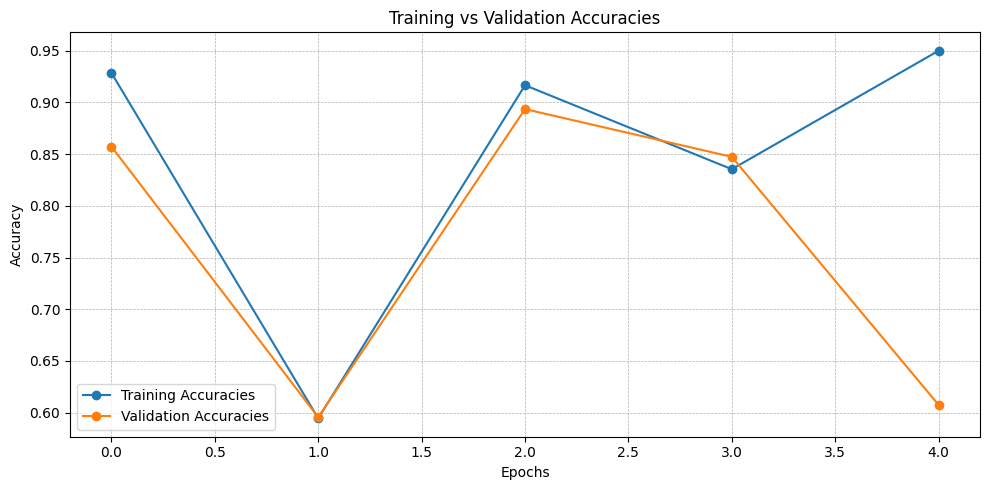

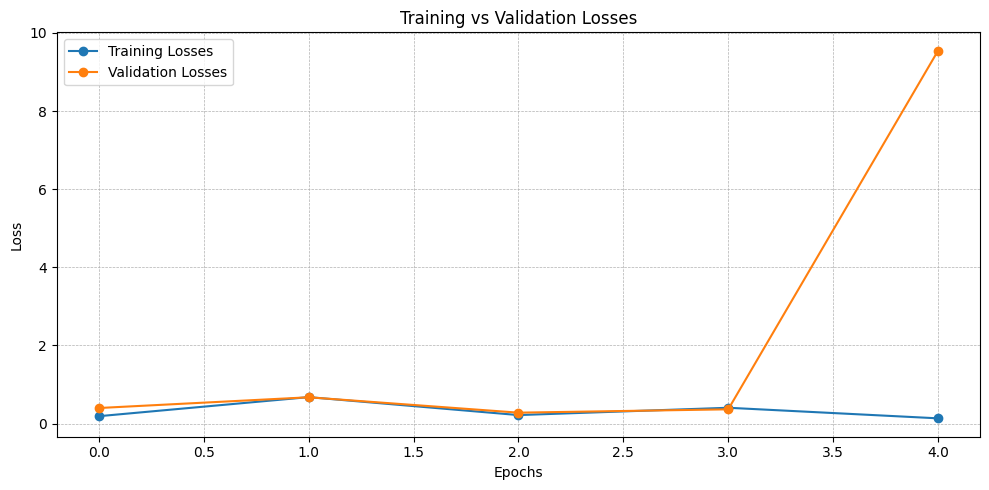

CPU times: user 482 ms, sys: 31.8 ms, total: 514 ms
Wall time: 580 ms


In [93]:
%%time 

def plot_tuner_results(tuner, data_val, val_predictions):
    
    """
    Plot training and validation accuracies and losses, and the ROC curve based on a given tuner's trials.
    """
    
    all_train_accuracies, all_val_accuracies, all_train_losses, all_val_losses = [], [], [], []

    for trial in tuner.oracle.trials.values():
        all_train_accuracies.append(trial.metrics.get_history('accuracy')[0].value)
        all_val_accuracies.append(trial.metrics.get_history('val_accuracy')[0].value)
        all_train_losses.append(trial.metrics.get_history('loss')[0].value)
        all_val_losses.append(trial.metrics.get_history('val_loss')[0].value)

    print(all_train_accuracies)
    
    epochs = list(range(len(all_train_accuracies)))

    # Plotting Accuracies
    
    epochs = list(range(len(all_train_accuracies)))
    plt.figure(figsize=(10, 5))
    plt.plot(all_train_accuracies, label="Training Accuracies", marker='o')
    plt.plot(all_val_accuracies, label="Validation Accuracies", marker='o')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title('Training vs Validation Accuracies')
    plt.legend()
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.tight_layout()
    plt.show()

    # Plotting Losses
    
    plt.figure(figsize=(10, 5))
    plt.plot(all_train_losses, label="Training Losses", marker='o')
    plt.plot(all_val_losses, label="Validation Losses", marker='o')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training vs Validation Losses')
    plt.legend()
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.tight_layout()
    plt.show()


plot_tuner_results(tuner2, data_val, val_predictions)


conclusion: the model is overfitting after 3 epochs.

### retraining

In [95]:
%%time

best_model.fit(data_train, epochs=2, validation_data=data_val, class_weight=class_weights, callbacks=[early_stopping, lr_reduction])


Epoch 1/2
3301/3301 [==============================] - 1267s 384ms/step - loss: 0.2944 - accuracy: 0.8924 - val_loss: 3.9812 - val_accuracy: 0.7184 - lr: 0.0015
Epoch 2/2
3301/3301 [==============================] - 1241s 376ms/step - loss: 0.2707 - accuracy: 0.8991 - val_loss: 1.1704 - val_accuracy: 0.5535 - lr: 0.0015
CPU times: user 2h 47min 31s, sys: 49min 52s, total: 3h 37min 24s
Wall time: 41min 49s


In [96]:
evaluate_and_plot_results(best_model, data_val)

1101/1101 [==============================] - 237s 215ms/step


              precision    recall  f1-score   support

           0       0.60      0.74      0.66     32758
           1       0.41      0.26      0.32     22248

    accuracy                           0.55     55006
   macro avg       0.50      0.50      0.49     55006
weighted avg       0.52      0.55      0.52     55006



### results

Given the problem is a serious issue, recall is the first option metric to evaluate the model, since I rather get the true positives labels right.
That being said, the recall results for Label 1 (cancer cells) was alarmingly low. The model is missing a substantial amount (74%) of the cancerous cells, which could have serious health implications in a real-world scenario.
The model needs improvement.

## model improvement test

- activation function changed from relu to leaky_relu;
- increased number of trials;
- added brightness and contrast adjustments to improve the image's interpretation; 
- changed learning rate reduction to monitor accuracy, instead of loss;
- changed binary_predictions method;

In [102]:
%%time

early_stopping = EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True)
lr_reduction = ReduceLROnPlateau(monitor='val_accuracy', factor=0.5, patience=2, verbose=1, min_lr=1e-6)
binary_predictions = np.where(val_predictions > optimal_threshold, 1, 0)


tuner3 = BayesianOptimization(
    build_model,
    objective= 'val_accuracy',
    max_trials= 8,
    num_initial_points= 2,
    directory= output_directory,
    project_name= 'histopathologic_cancer_detection_bayesian'
)


INFO:tensorflow:Reloading Tuner from /Users/flaviab/Downloads/histopathologic-cancer-detection/outputs/histopathologic_cancer_detection_bayesian/tuner0.json
CPU times: user 18.7 ms, sys: 57.2 ms, total: 75.9 ms
Wall time: 141 ms


In [103]:
%%time

tuner3.search(data_train, epochs=10, validation_data=data_val, callbacks=[early_stopping, lr_reduction])
best_model = tuner3.get_best_models(num_models=1)[0]

Trial 8 Complete [03h 50m 37s]
val_accuracy: 0.9045558571815491

Best val_accuracy So Far: 0.9045558571815491
Total elapsed time: 19h 36m 38s
INFO:tensorflow:Oracle triggered exit
CPU times: user 3d 9min 1s, sys: 1d 4h 14min 59s, total: 4d 4h 24min 1s
Wall time: 19h 36min 42s


In [104]:
%%time

predictions = best_model.predict(data_test)

1150/1150 [==============================] - 121s 105ms/step
CPU times: user 7min 20s, sys: 3min 3s, total: 10min 24s
Wall time: 2min 1s


In [105]:
%%time

def optimize_and_evaluate_model(build_model_function, 
                                data_train, 
                                data_val, 
                                data_test,
                                output_directory,
                                max_trials=4, 
                                epochs=6,
                                num_initial_points=2, 
                                project_name='histopathologic_cancer_detection_bayesian'):
    """
    Optimize a Keras model using Bayesian optimization and evaluate its performance.
    """

    tuner3 = BayesianOptimization(
        build_model_function,
        objective='val_accuracy',
        max_trials=max_trials,
        num_initial_points=num_initial_points,
        directory=output_directory,
        project_name=project_name
    )

    tuner3.search(data_train, epochs=epochs, validation_data=data_val)
    best_model = tuner3.get_best_models(num_models=1)[0]
    
    val_loss, val_accuracy = best_model.evaluate(data_val)
    print(f"Validation Accuracy: {val_accuracy*100:.2f}%")
    print(f"Validation Loss: {val_loss:.4f}")

    return best_model, val_loss, val_accuracy, tuner3

best_model, val_loss, val_accuracy, tuner3 = optimize_and_evaluate_model(build_model, data_train, data_val, data_test, output_directory)


INFO:tensorflow:Reloading Tuner from /Users/flaviab/Downloads/histopathologic-cancer-detection/outputs/histopathologic_cancer_detection_bayesian/tuner0.json
INFO:tensorflow:Oracle triggered exit
1101/1101 [==============================] - 236s 214ms/step - loss: 0.2500 - accuracy: 0.9060
Validation Accuracy: 90.60%
Validation Loss: 0.2500
CPU times: user 8min 57s, sys: 2min 53s, total: 11min 50s
Wall time: 3min 56s


### evaluate again

In [109]:
%%time 

val_predictions = best_model.predict(data_val)
thresholds = np.arange(0, 1.05, 0.05)
f1_scores = [f1_score(true_labels, np.where(val_predictions > t, 1, 0)) for t in thresholds]
optimal_threshold = thresholds[np.argmax(f1_scores)]

1101/1101 [==============================] - 228s 207ms/step
CPU times: user 8min 56s, sys: 2min 57s, total: 11min 53s
Wall time: 3min 49s


[[0.5944527387619019], [0.8354189395904541], [0.9166581034660339], [0.9102345705032349], [0.9286627769470215], [0.911713182926178], [0.9500481486320496], [0.9671310782432556]]


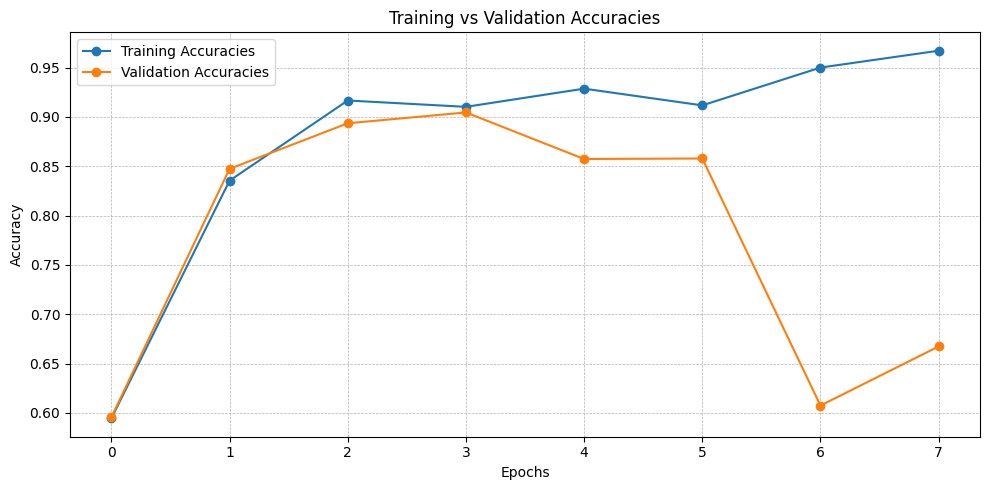

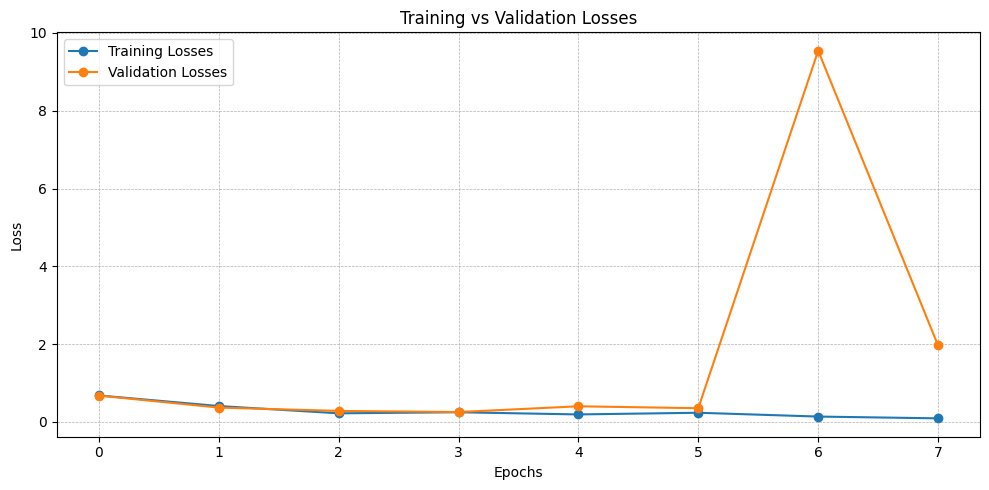

CPU times: user 423 ms, sys: 51.8 ms, total: 475 ms
Wall time: 540 ms


In [110]:
%%time 

plot_tuner_results(tuner3, data_val, val_predictions)


### model train with 3 epochs and 

In [116]:
%%time

best_model.fit(data_train, epochs=3, validation_data=data_val, class_weight=class_weights, callbacks=[early_stopping, lr_reduction])


Epoch 1/3
3301/3301 [==============================] - 1482s 448ms/step - loss: 0.2429 - accuracy: 0.9113 - val_loss: 0.4452 - val_accuracy: 0.8377 - lr: 1.2377e-04
Epoch 2/3
3301/3301 [==============================] - 1409s 427ms/step - loss: 0.2319 - accuracy: 0.9162 - val_loss: 0.3666 - val_accuracy: 0.8643 - lr: 1.2377e-04
Epoch 3/3
3301/3301 [==============================] - 1410s 427ms/step - loss: 0.2238 - accuracy: 0.9194 - val_loss: 0.2965 - val_accuracy: 0.8799 - lr: 1.2377e-04
CPU times: user 4h 21min 53s, sys: 1h 18min 15s, total: 5h 40min 9s
Wall time: 1h 11min 41s


In [117]:
%%time

evaluate_and_plot_results(best_model, data_val)


1101/1101 [==============================] - 239s 217ms/step


              precision    recall  f1-score   support

           0       0.59      0.61      0.60     32758
           1       0.40      0.39      0.40     22248

    accuracy                           0.52     55006
   macro avg       0.50      0.50      0.50     55006
weighted avg       0.52      0.52      0.52     55006



CPU times: user 8min 57s, sys: 2min 53s, total: 11min 51s
Wall time: 4min


### Results

The final test showed a slightly better result than the others in improving the recall metric, which is the one chosen to evaluate the model. 
Despite this, the model still has many areas that need improvement, requiring more computational resources to continue being refined.